In [ ]:
import numpy as np
from matplotlib.backends.backend_pdf import PdfPages
from result_manager.result_manager import ResultManager
from matplotlib import pyplot as plt
import sys
sys.path.append('../..')
from mouse_lgn.lgn_statistics import load_lgn_statistics
from lgnpy.CEandSC.lgn_statistics import *

ModuleNotFoundError: No module named 'CEandSC'

In [14]:
# Test save csv
ce = [np.zeros((3)) for _ in range(10)]
sc = [np.ones((3)) for _ in range(10)]
res = {'CE': ce, 'SC': sc}
import csv
from scipy.io import savemat

savemat(file_name='mat_test.mat', mdict=res)
# with open('csv_test.csv', 'w+') as f:
#     write = csv.writer(f, delimiter='\t')
#     write.writerows(res.items())

# Load LGN statistics

In [155]:
ce, sc, beta, gamma, filenames = load_lgn_statistics(
    filepath='/home/niklas/projects/oads_access/analysis/LGNstatistics_OADS_test.mat', drop_colors=False)

Could not load mat file with mat73 - trying to load with scipy.io.loadmat!


In [159]:
print(ce[:,0])
print(sc[:,0])

[0.00256608 0.0002702  0.00604406 0.00036244 0.0002798  0.00204361
 0.00103515 0.0046939  0.00050136 0.00274227 0.00099734 0.00231107
 0.00284712 0.00166173]
[0.69195667 0.42140413 0.8336309  0.44966793 0.49734921 0.56994726
 0.47460907 1.10632707 0.67563482 0.59956453 0.48232852 0.76893714
 0.88593242 0.85793914]


## Load separate files

In [9]:
import os
basedir = '/mnt/c/Users/nikla/OneDrive/PhD/Projects/LGNstatistics-master/results'
file_names = os.listdir(basedir)
for file_name in file_names:
    if '.tiff' in file_name:
        image_id = file_name.split('_')[-1].split('.tiff')[0]
        ce, sc, beta, gamma, filenames = load_lgn_statistics(filepath=os.path.join(basedir, file_name), drop_colors=False)
        
        break
    else:
        continue

Could not load mat file with mat73 - trying to load with scipy.io.loadmat!


OSError: [Errno 5] Input/output error

# Sample crops from full scenes

In [2]:
from PIL import Image
import os

In [3]:
basedir = '/home/niklas/projects/data/oads'

In [4]:
image_names = os.listdir(os.path.join(basedir, 'oads_arw', 'tiff'))

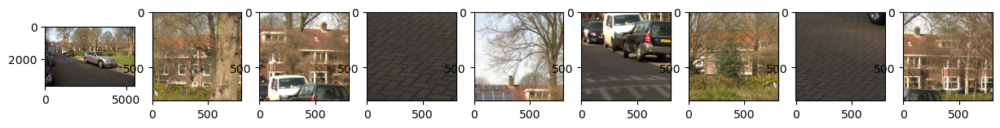

In [10]:
number_crops_per_image = 8
crop_size = (800, 800)

fig, ax = plt.subplots(1,number_crops_per_image+1, figsize=(15,10))

def get_random_crops(img, n_crops, crop_size):
    crops = []
    for index in range(number_crops_per_image):
        left = np.random.randint(low=0, high=size[0] - crop_size[0])
        upper = np.random.randint(low=0, high=size[1] - crop_size[1])
        right = left+crop_size[0]
        lower = upper+crop_size[1]
        box = (left, upper, right, lower)
        crop = img.crop(box)
        crops.append(crop)

    return crops

for index, image_name in enumerate(image_names):
    if index > 1:
        break
    img = Image.open(os.path.join(basedir, 'oads_arw', 'tiff', image_name))
    ax[0].imshow(img)
    size = img.size
    for crop_index, crop in enumerate(get_random_crops(img=img, n_crops=number_crops_per_image, crop_size=crop_size)):
        ax[crop_index+1].imshow(crop)

# Compute SC/CE

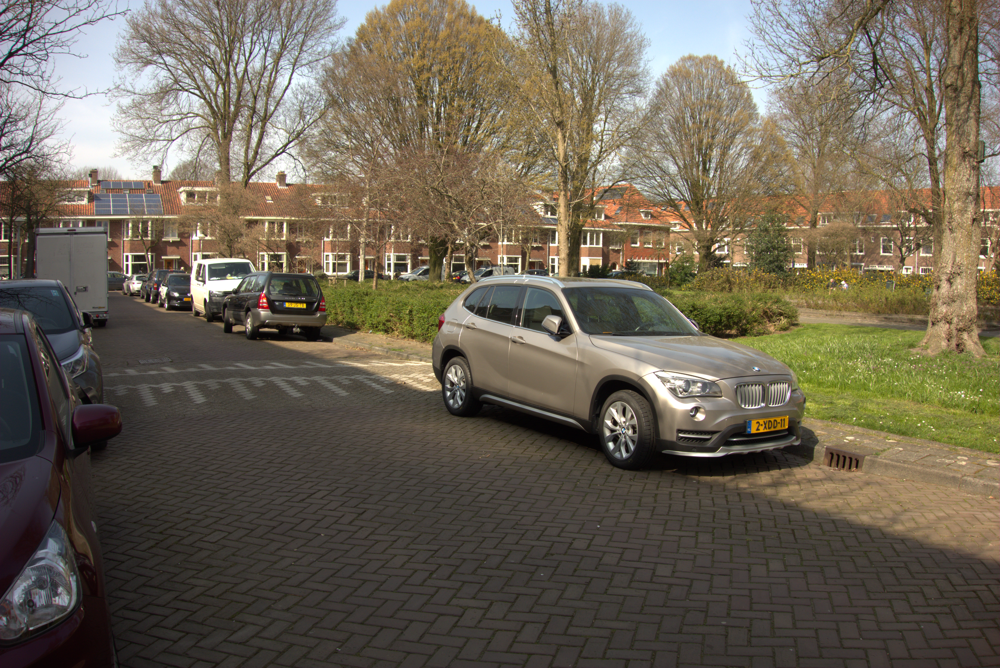

In [11]:
img

# Get Uniform Distribution of SC/CE

In [7]:
# Simulate CE and SC
sc = np.random.normal(loc = 1, scale=0.1, size=(1000))
ce = np.random.normal(loc = 1, scale=0.1, size=(1000))

In [13]:
# Uniform distribution
u = np.random.uniform(0.6, 1.4, size=(400))

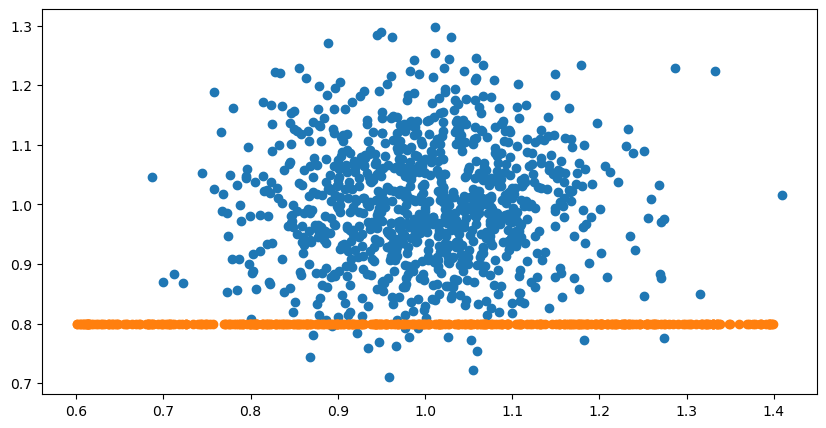

In [16]:
fig, ax = plt.subplots(1,1, figsize=(10,5))
ax.scatter(ce, sc)
ax.scatter(u, np.ones(u.shape) * 0.8)

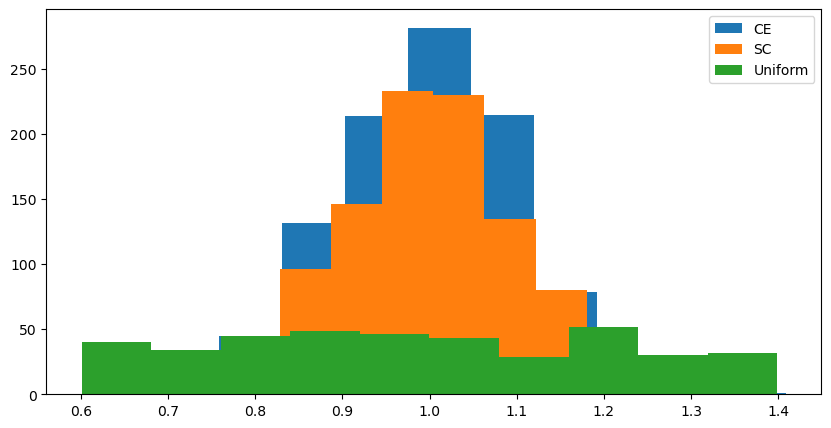

In [17]:
fig, ax = plt.subplots(1,1, figsize=(10,5))
ax.hist(ce, label='CE')
ax.hist(sc, label='SC')
ax.hist(u, label='Uniform')

plt.legend()

In [152]:
ce_lower = np.percentile(ce, q=25)
ce_upper = np.percentile(ce, q=75)
sc_lower = np.percentile(sc, q=25)
sc_upper = np.percentile(sc, q=75)

In [115]:
count_ce, division_ce = np.histogram(ce[(ce > ce_lower) & (ce < ce_upper)])

min_count_ce = count_ce.min()
min_value_ce = division_ce.min()
max_value_ce = division_ce.max()

print(min_count_ce, min_value_ce, max_value_ce)

count_sc, division_sc = np.histogram(sc[(sc > sc_lower) & (sc < sc_upper)])

min_count_sc = count_sc.min()
min_value_sc = division_sc.min()
max_value_sc = division_sc.max()

print(min_count_sc, min_value_sc, max_value_sc)

39 0.9294573618375023 1.0695864432920166
44 0.9374426655501177 1.0652926868178647


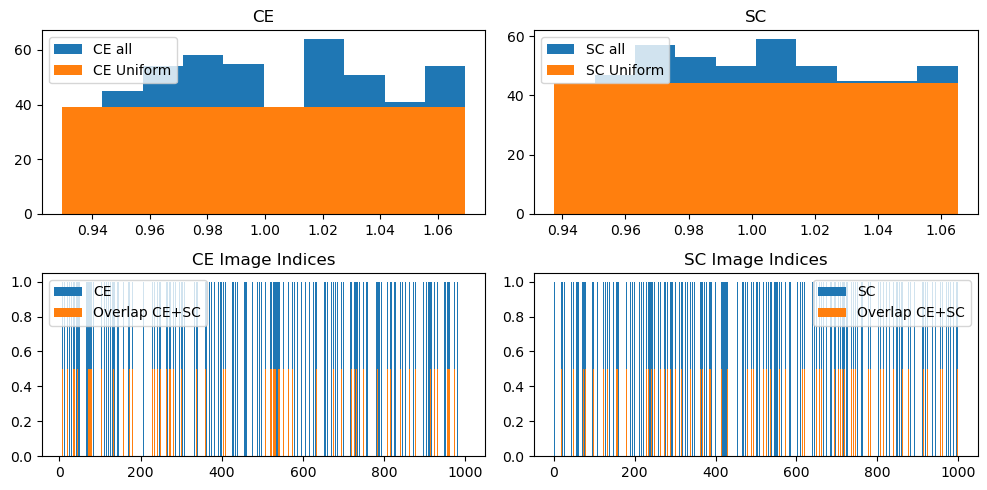

In [139]:
fig, ax = plt.subplots(2,2, figsize=(10,5))

def get_bin_values(data, bins, min_count):
    # Get index of bin for each entry in data
    indices = np.digitize(x=data, bins=bins)

    index_array = np.array([i for i in range(len(data))])
    
    # For each bin, gather the indices of the data array, shuffle them and only take min_count many to balance the size of the bins
    # This index array can then be used to get the images corresponding to the CE/SC values that were chosen, now having a uniform distribution
    bin_indices = np.array([np.random.permutation(index_array[indices == i])[:min_count] for i in range(len(bins))])

    # Get the actual data points for each bin
    bin_values = np.array([data[bin_indices[i]] for i in range(len(bins))])
    return bin_indices, bin_values

indices_ce, values_ce = get_bin_values(data=ce, bins=division_ce, min_count=min_count_ce)
ax[0, 0].hist(ce, bins=division_ce, label='CE all')
ax[0, 0].hist(values_ce.flatten(), bins=division_ce, label='CE Uniform')
ax[0, 0].set_title('CE')
ax[0, 0].legend()

indices_sc, values_sc = get_bin_values(data=sc, bins=division_sc, min_count=min_count_sc)
ax[0, 1].hist(sc, bins=division_sc, label='SC all')
ax[0, 1].hist(values_sc.flatten(), bins=division_sc, label='SC Uniform')
ax[0, 1].set_title('SC')
ax[0, 1].legend()


## Plot the indices
index_overlap = np.intersect1d(indices_ce.flatten(), indices_sc.flatten())
ax[1,0].bar(x=indices_ce.flatten(), height=1, label='CE')
ax[1,0].bar(x=index_overlap, height=0.5, label='Overlap CE+SC')
ax[1,0].set_title('CE Image Indices')
ax[1,1].bar(x=indices_sc.flatten(), height=1, label='SC')
ax[1,1].bar(x=index_overlap, height=0.5, label='Overlap CE+SC')
ax[1,1].set_title('SC Image Indices')

ax[1,0].legend()
ax[1,1].legend()

plt.tight_layout()
plt.show()

# Look into center-peripherie difference

In [1]:
threshold_lgn = loadmat('/home/niklas/projects/LGNstatistics-master/CEandSCmatlab/ThresholdLGN.mat')
threshold_lgn = threshold_lgn['ThresholdLGN']

result_manager = ResultManager(root='/home/niklas/projects/oads_access/analysis/results')

results = result_manager.load_result('lgn_statistics.pkl')

NameError: name 'loadmat' is not defined